In [7]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import random
import sys

sys.path.append('../')
from ConformalMethods import AdaptiveCP, ACP_data, ACP_plots

We want to create a dtaci equivilent where we run multiple dtaci in parrelel with different lookbacks and then choose the most suitable ones. Need to have some form of modular head, which is a generator for the coverage window, then will simply use the l1 loss for a reweighting scheme and you will likley have a scale which you will eventually have to find. 

Below we have the code for the heads.

In [8]:
class AwDtAci_place(AdaptiveCP):
    def __init__(self, coverage):
        self.coverage_target = coverage
        self.interval_size = 50
        self.score_function = lambda xpred, y: (abs(y - xpred))/abs(xpred)
        self.neg_inverse_score =  lambda x_t, Q: (x_t) - (abs(x_t) * Q)
        self.pos_inverse_score = lambda x_t, Q: (x_t) + (abs(x_t) * Q)

    def DtACI_head(self, timeseries_data: tuple, custom_interval: int = None, start_point: int = None, gamma_candidates: np.array = None,  title: str = None):
        '''start_point: The value which the head will start calculating from'''
        
        xpred, y = timeseries_data
        if gamma_candidates is None:
            gamma_candidates = np.array([0.001, 0.004, 0.032, 0.064, 0.128, 0.256, 0.512])

        # we need a vectorised version of l
        l_vec = self.vectorize_l()
        
        candiate_alpha = np.array([[self.coverage_target for _ in gamma_candidates]])
        gamma_weights = np.array([1 for _ in gamma_candidates])
        
        chosen_gamma_index = []
        err_t_list = []
        conformal_sets_list = []
        alpha_t_list = []
        alpha_error_list = []
        B_t_list = []
        
        sigma = 1/(2*custom_interval)
        nu = np.sqrt((3/custom_interval) * (np.log(len(gamma_candidates)*custom_interval) + 2)/((1-self.coverage_target)**2 * self.coverage_target**2))

        # Calculating the scores at each time step
        All_scores = self.score_function(xpred, y)

        for i in range(start_point, len(All_scores)):
            # Calcualting the probability of each gamma from the weights from step t-1.
            Wt = gamma_weights.sum()
            gamma_probabilites = gamma_weights/Wt
            
            # Choosing a alpha from the probabilites from the gamma candidates.
            chosen_alpha_t = np.random.choice(candiate_alpha[-1], p=gamma_probabilites)
            alpha_t_list.append(chosen_alpha_t)
            candiate_alpha_index = np.where(candiate_alpha[-1] == chosen_alpha_t)[0][0]
            chosen_gamma_index.append(candiate_alpha_index)

            Coverage_t = self.C_t(chosen_alpha_t, All_scores, xpred[i], i, custom_interval)
            conformal_sets_list.append(Coverage_t)

            # Yield the conformal set
            yield Coverage_t
            
            err_true = AdaptiveCP.err_t(y[i], Coverage_t)
            err_t_list.append(err_true)

            # TIME FRONTIER -------

            # Smallest interval containg the true value.
            #B_t = 0.5       # To avoid unbound local error will assign B_t a value first
            for possi in np.linspace(1, 0, 1000):
                Cpossi= self.C_t(possi, All_scores, xpred[i], i)
                if Cpossi[0] < y[i] < Cpossi[1]:
                    B_t = possi
                    break
            
            B_t_list.append(B_t)
            
            # Updating the weights.
            new_weights = gamma_weights * np.exp(-nu * l_vec(B_t, candiate_alpha[-1]))
            
            sumW, lenW = sum(new_weights), len(new_weights)
            final_weights = new_weights*(1-sigma) + sumW*(sigma/lenW)
            gamma_weights = final_weights

            # Calculating the coverage and error at each time step, for different alpha values.
            alphai_errors = np.array([AdaptiveCP.err_t(y[i], self.C_t(alpha_i, All_scores, xpred[i], i)) for alpha_i in candiate_alpha[-1]])
            alpha_error_list.append(alphai_errors)

            # Updating the alpha values.
            new_alphas = candiate_alpha[-1] + (gamma_candidates * (self.coverage_target - alphai_errors))
            candiate_alpha = np.vstack((candiate_alpha, new_alphas))
        
        print(B_t_list)
        return False



Below is the AwDtAci method.

In [9]:
class test(AdaptiveCP):
    def __init__(self, coverage_target):
        self.interval_size = 50
        self.coverage_target = coverage_target

    def new_l_vec(self, optimal_set, given_set):
         val = optimal_set - given_set
         if val < 0:
              return (self.coverage_target) * (-1* val)
         else:
              return (1 - self.coverage_target) * val
    
    def new_vectorize(self):
         return np.vectorize(self.new_l_vec)

    def AwDtAci(self, timeseries_data: tuple, interval_candidates: np.array = None, title: str = None):
        xpred, y = timeseries_data

        chosen_interval_index = []
        err_t_list = []
        conformal_sets_list = []
        optimal_radius_list = []
        chosen_radius_list = []

        if interval_candidates is None:
            interval_candidates = np.array(range(50, 550, 100))

        # To sync all of the heads we need to start at the max of all the candidates.
        start_point = max(interval_candidates) + 1

        # Create the head and intitialse the weights.
        AwDtAci_place_instance = AwDtAci_place(self.coverage_target)
        DtACI_heads = [AwDtAci_place_instance.DtACI_head(timeseries_data, interval, start_point) for interval in interval_candidates]
        interval_weights = np.array([1 for _ in range(len(interval_candidates))])

        # Scaling the parameters, there is no way these are the best ways.
        sigma = 1/(2*self.interval_size)
        nu = 10**-3 # needs to be at least minus two for anything to work.
        
        l_vec = self.new_vectorize()

        none_terminated = True
        i_count = start_point
        
        while none_terminated: # Continues calculating intervals until one of the heads stops.
            head_sets = []
            
            # Create the mass distribution for each head
            Wt = interval_weights.sum()
            interval_probabilites = interval_weights/Wt
        
            # Create a list of the coverages for the different heads.
            try:
                for head in DtACI_heads:
                        head_sets.append(next(head))
            
            except StopIteration: # The head is terminated.
                none_terminated = False
                break # You could but the return statement here

            # Choosing which head to use.
            chosen_set = random.choices(head_sets, weights=interval_probabilites, k=1)[0] # Using random module as numpy can not deal with tuples.
            conformal_sets_list.append(chosen_set)
            chosen_interval_index.append(head_sets.index(chosen_set))

            # TIME FRONTIER -------------

            # Seeing whether result lies within the set.
            err_true = AdaptiveCP.err_t(y[i_count], chosen_set)
            err_t_list.append(err_true)

            # Finding the best possible set. 
            optimal_set_radius = xpred[i_count] - xpred[i_count-1]
            head_set_radius = list(map(lambda Cset: (Cset[1] - Cset[0])/2, head_sets)) #(chosen_set[1] - chosen_set[0])/2

            optimal_radius_list.append(optimal_set_radius)
            chosen_radius_list.append((chosen_set[1] - chosen_set[0]/2))
            
            #l1_error = abs(optimal_set_radius - np.array(head_set_radius))
            head_set_radius = np.array(head_set_radius)
            l1_error = l_vec(optimal_set_radius, head_set_radius)

            # Updating the weights.
            new_weights = interval_weights * np.exp( nu * l1_error ) # Removed negative from previous paper.
            
            sumW, lenW = sum(new_weights), len(new_weights)
            final_weights = new_weights*(1-sigma) + sumW*(sigma/lenW)
            interval_weights = final_weights

            # Incrementing the i-count
            i_count+=1

        # Calculating different averages
        realised_interval_coverage = 1 - pd.Series(err_t_list).rolling(50).mean().mean() # 50 is arbitary and could be improved.
        average_prediction_interval = np.mean([abs(x[1] - x[0]) for x in conformal_sets_list])

        return {
                'model': title if title is not None else 'AwDtACI',
                'coverage_target': self.coverage_target,
                'interval_candidates': interval_candidates,
                'realised_interval_coverage': realised_interval_coverage,
                'average_prediction_interval': average_prediction_interval,
                'optimal_set_radius': optimal_radius_list, 
                'chosen_set_radius': chosen_radius_list,
                'conformal_sets': conformal_sets_list,
                'error_t_list': err_t_list,
                'chosen_interval_index': chosen_interval_index,
                'start_point': start_point,
                'interval_size': 50
            }

Making a nice plotter for this type.

In [101]:
import matplotlib.gridspec as gridspec

@staticmethod
def AwDT_plot(data, dist: tuple, comparison = False):
    y = dist[1]
    error_list = data['error_t_list']
    conformal_sets = data['conformal_sets']
    coverage = data['realised_interval_coverage']
    interval_size = data['interval_size']
    interval_candidates = data['interval_candidates']
    average_prediction_interval = data['average_prediction_interval']

    chosen_interval_index  = data['chosen_interval_index']
    start_point = data['start_point']

    if comparison:
        ACP = AdaptiveCP(data['coverage_target'])
        Dt_data = ACP.DtACI(dist, custom_interval=max(interval_candidates))
        ACI_data = ACP.ACI(dist, 0.05)

    fig = plt.figure(figsize=(30, 20))
    gs = gridspec.GridSpec(5, 2, figure=fig)

    # Realised Coverage
    ax1 = fig.add_subplot(gs[0, :])
    ax1.plot(1 - pd.Series(error_list).rolling(interval_size).mean(), label='AwDtAci', color='b')
    ax1.axhline(coverage, color='b', linestyle='--')
    ax1.set_xlim(min(interval_candidates), len(y) - start_point)
    ax1.set_title('Realised Coverage')

    # Distance between upper and lower bounds
    ax2 = fig.add_subplot(gs[1, :])
    diff = [ele[1]-ele[0] for ele in conformal_sets]
    ax2.plot(diff, label='Distance')
    ax2.axhline(np.mean(diff), color='r', linestyle='--')
    ax2.set_xlim(min(interval_candidates), len(y) - start_point)
    ax2.set_ylim(bottom=0)
    ax2.set_title('Distance between upper and lower bounds')

    # Conformal sets
    ax3 = fig.add_subplot(gs[2:4, :])
    lower, upper = [ele[0] for ele in conformal_sets], [ele[1] for ele in conformal_sets]
    ax3.plot(lower, label='Lower')
    ax3.plot(upper, label='Upper')
    ax3.plot(y[start_point:])
    ax3.set_title('Conformal sets')
    ax3.set_ylim(bottom=np.percentile(lower, 2.5), top=np.percentile(upper, 97.5))
    ax3.set_xlim(0, len(y) - start_point)

    ax4 = fig.add_subplot(gs[4,0])
    ax4.plot(chosen_interval_index,label='chosen_interval_index')
    ax4.set_title('Chosen Interval')

    ax5 = fig.add_subplot(gs[4,1])
    ax5.axhline(average_prediction_interval, label='AwDtAci')

    if comparison:
        # Realised Coverage comparison
        comparison_error_list = Dt_data['error_t_list']
        comparison_coverage = Dt_data['realised_interval_coverage']
        comparison_prediciton_interval = Dt_data['average_prediction_interval']

        ax1.plot(1 - pd.Series(comparison_error_list).rolling(interval_size).mean(), linestyle='--', label='DtAci')
        ax1.axhline(comparison_coverage, color='g', linestyle=':')

        # Distance between upper and lower bounds comparison
        comparison_conformal_sets = Dt_data['conformal_sets']
        comparison_diff = [ele[1]-ele[0] for ele in comparison_conformal_sets]
        ax2.plot(comparison_diff, label='Comparison Distance', linestyle='--')
        ax2.axhline(np.mean(comparison_diff), color='g', linestyle=':', label='comparison average' )

        # Conformal sets comparison
        comparison_lower, comparison_upper = [ele[0] for ele in comparison_conformal_sets], [ele[1] for ele in comparison_conformal_sets]
        ax3.plot(comparison_lower, label='Comparison Lower', linestyle='--')
        ax3.plot(comparison_upper, label='Comparison Upper', linestyle='--')

        ax5.axhline(comparison_prediciton_interval, color='g', label='DtACI')

        aci_error_list = ACI_data['error_t_list']
        aci_coverage = ACI_data['realised_interval_coverage']
        aci_prediction_interval = ACI_data['average_prediction_interval']
        
        ax1.plot(1 - pd.Series(aci_error_list).rolling(interval_size).mean(), linestyle='-.', label='ACI Error')
        ax1.axhline(aci_coverage, color='r', linestyle='-.', label='ACI Coverage')
        
        ax5.axhline(aci_prediction_interval, color='r', label='ACI Prediction Interval')

    ax1.legend()
    ax2.legend()
    ax3.legend()
    ax4.legend()
    ax5.legend()

    plt.show()



In [11]:
single_shift = ACP_data.single_shift(seq_length=750)[0]

In [94]:
t = test(0.4)
result = t.AwDtAci(single_shift)

[np.float64(0.12312312312312312), np.float64(0.7587587587587588), np.float64(0.32832832832832837), np.float64(0.05905905905905906), np.float64(0.5305305305305306), np.float64(0.9209209209209209), np.float64(0.4614614614614615), np.float64(0.24524524524524527), np.float64(0.8268268268268268), np.float64(0.36036036036036034), np.float64(0.7997997997997999), np.float64(0.20320320320320318), np.float64(0.7227227227227226), np.float64(0.7537537537537538), np.float64(0.5365365365365365), np.float64(1.0), np.float64(0.7247247247247247), np.float64(0.3623623623623624), np.float64(0.0570570570570571), np.float64(0.9519519519519519), np.float64(0.8628628628628628), np.float64(0.1811811811811812), np.float64(0.6306306306306306), np.float64(0.6836836836836837), np.float64(0.7957957957957957), np.float64(0.1811811811811812), np.float64(0.7287287287287287), np.float64(0.9359359359359359), np.float64(0.7857857857857857), np.float64(0.7567567567567568), np.float64(0.991991991991992), np.float64(1.0), 

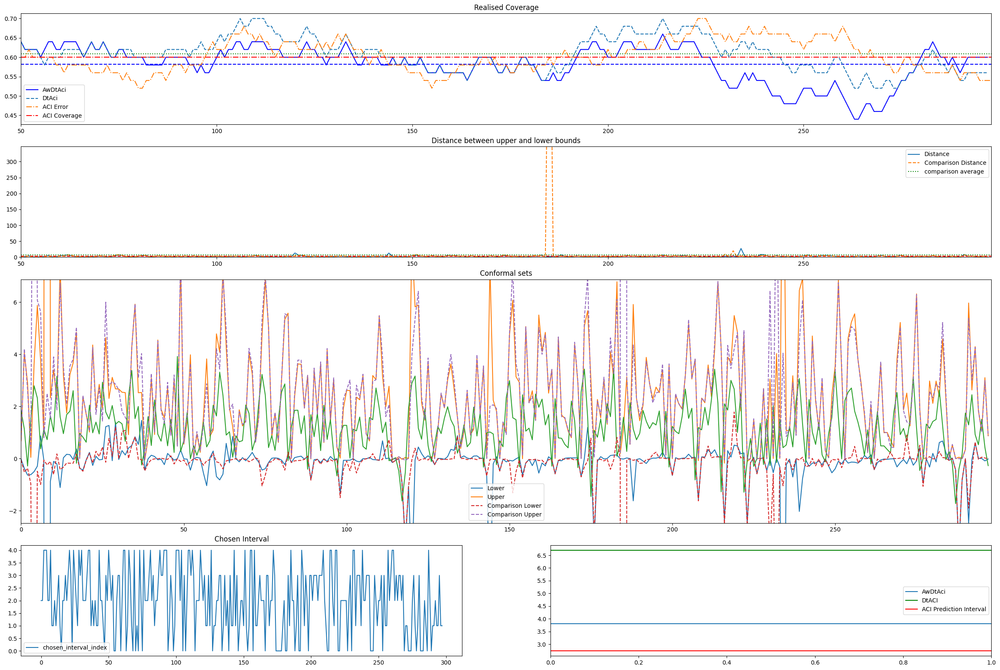

In [102]:
AwDT_plot(result, single_shift, True)

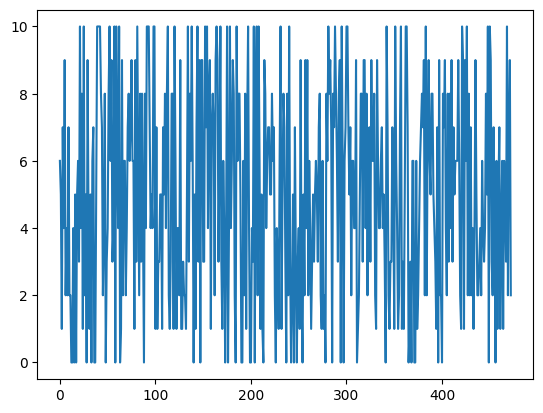

In [ ]:
plt.plot(result['chosen_interval_index'])
plt.show()

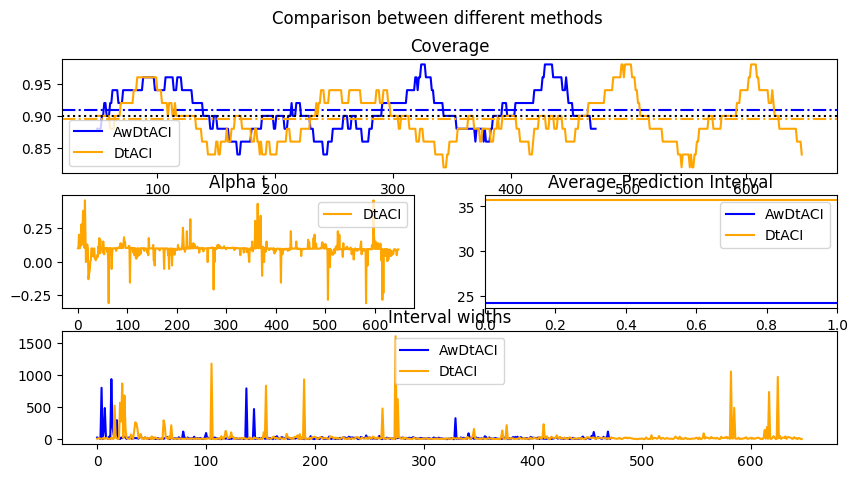

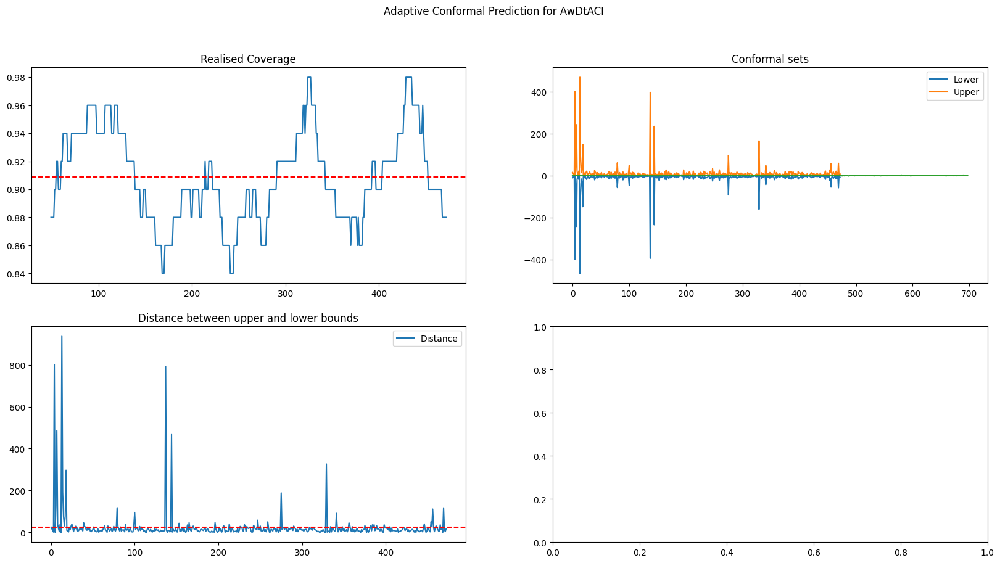

In [ ]:
ACP = AdaptiveCP(0.1)
ACP_plots.compare_many([result, ACP.DtACI(single_shift, custom_interval=100)])
ACP_plots.one_plot(result, single_shift[1])

In [85]:
random_shift = ACP_data.random_multi_shift(1, (2000,2001))[0]
random_result = t.AwDtAci(random_shift)

[np.float64(0.7477477477477478), np.float64(0.026026026026025995), np.float64(0.5645645645645645), np.float64(0.18018018018018023), np.float64(0.8758758758758759), np.float64(0.8988988988988988), np.float64(0.8328328328328328), np.float64(0.24524524524524527), np.float64(0.21421421421421427), np.float64(0.17017017017017022), np.float64(0.25125125125125125), np.float64(0.6476476476476476), np.float64(0.8508508508508509), np.float64(0.1141141141141141), np.float64(1.0), np.float64(0.8268268268268268), np.float64(0.953953953953954), np.float64(0.6266266266266266), np.float64(0.05305305305305308), np.float64(0.6256256256256256), np.float64(0.1561561561561562), np.float64(0.92992992992993), np.float64(0.3053053053053053), np.float64(0.9309309309309309), np.float64(0.6536536536536537), np.float64(0.09509509509509506), np.float64(0.968968968968969), np.float64(0.39239239239239243), np.float64(0.4194194194194194), np.float64(0.15815815815815815), np.float64(0.974974974974975), np.float64(0.866

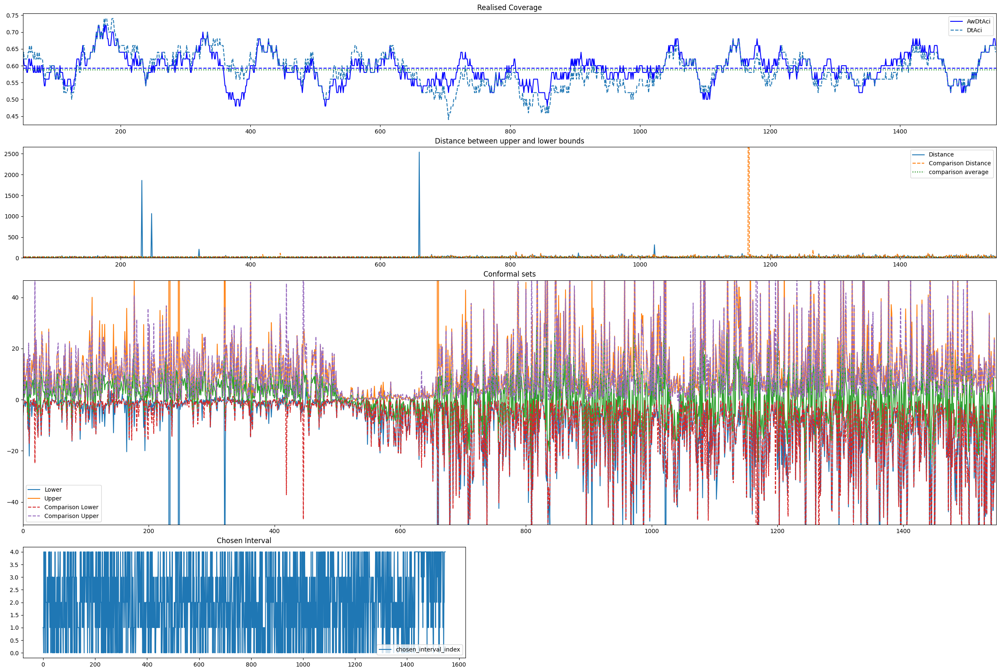

In [86]:
AwDT_plot(random_result, random_shift, True)

# Trying on Multiple Data.

[np.float64(0.1611611611611612), np.float64(0.15415415415415412), np.float64(0.5905905905905906), np.float64(0.2582582582582582), np.float64(0.4764764764764765), np.float64(0.9309309309309309), np.float64(0.48948948948948945), np.float64(0.12312312312312312), np.float64(0.4044044044044044), np.float64(0.25225225225225223), np.float64(0.8048048048048049), np.float64(0.1551551551551552), np.float64(0.5495495495495495), np.float64(0.984984984984985), np.float64(0.2482482482482482), np.float64(0.44744744744744747), np.float64(1.0), np.float64(0.8708708708708709), np.float64(0.3613613613613613), np.float64(0.3363363363363363), np.float64(0.8198198198198199), np.float64(0.7577577577577578), np.float64(0.3943943943943944), np.float64(0.9429429429429429), np.float64(0.990990990990991), np.float64(0.40740740740740744), np.float64(0.4034034034034034), np.float64(0.5055055055055055), np.float64(0.014014014014014031), np.float64(0.8608608608608609), np.float64(0.5035035035035035), np.float64(0.177

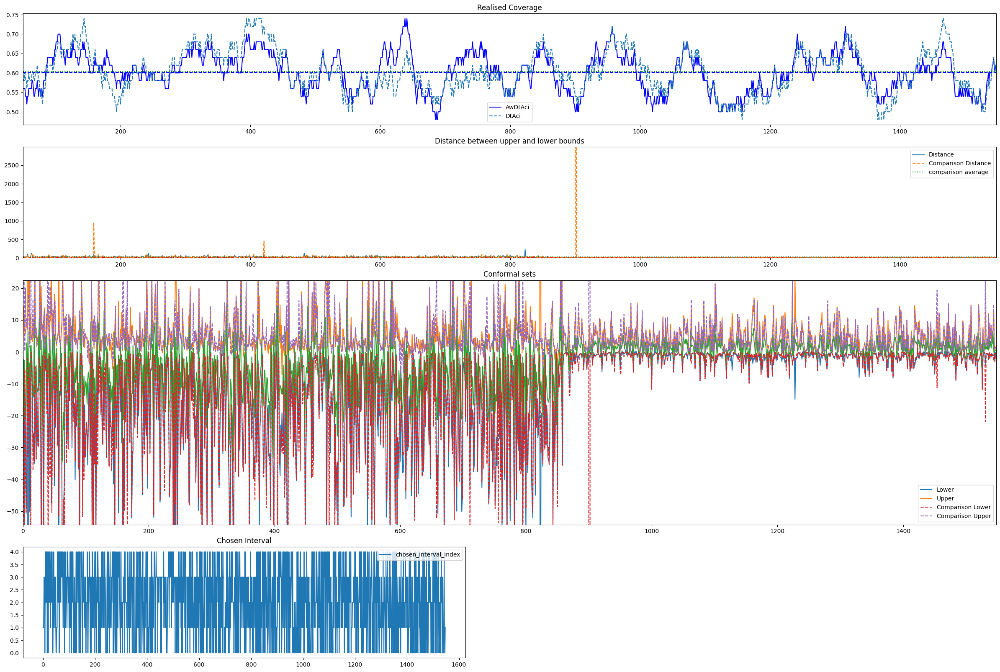

[np.float64(0.8848848848848849), np.float64(0.4394394394394394), np.float64(0.19619619619619622), np.float64(0.21921921921921927), np.float64(0.934934934934935), np.float64(0.7557557557557557), np.float64(0.7247247247247247), np.float64(0.9359359359359359), np.float64(0.4764764764764765), np.float64(0.4764764764764765), np.float64(0.8698698698698699), np.float64(0.8148148148148149), np.float64(0.19419419419419415), np.float64(0.1811811811811812), np.float64(0.26226226226226224), np.float64(0.3513513513513513), np.float64(0.3623623623623624), np.float64(0.6976976976976976), np.float64(0.48348348348348347), np.float64(0.48348348348348347), np.float64(0.7137137137137137), np.float64(0.3213213213213213), np.float64(0.5555555555555556), np.float64(0.23623623623623624), np.float64(0.7367367367367368), np.float64(0.8248248248248249), np.float64(0.31331331331331336), np.float64(0.2652652652652653), np.float64(0.4464464464464465), np.float64(0.7677677677677678), np.float64(0.974974974974975), n

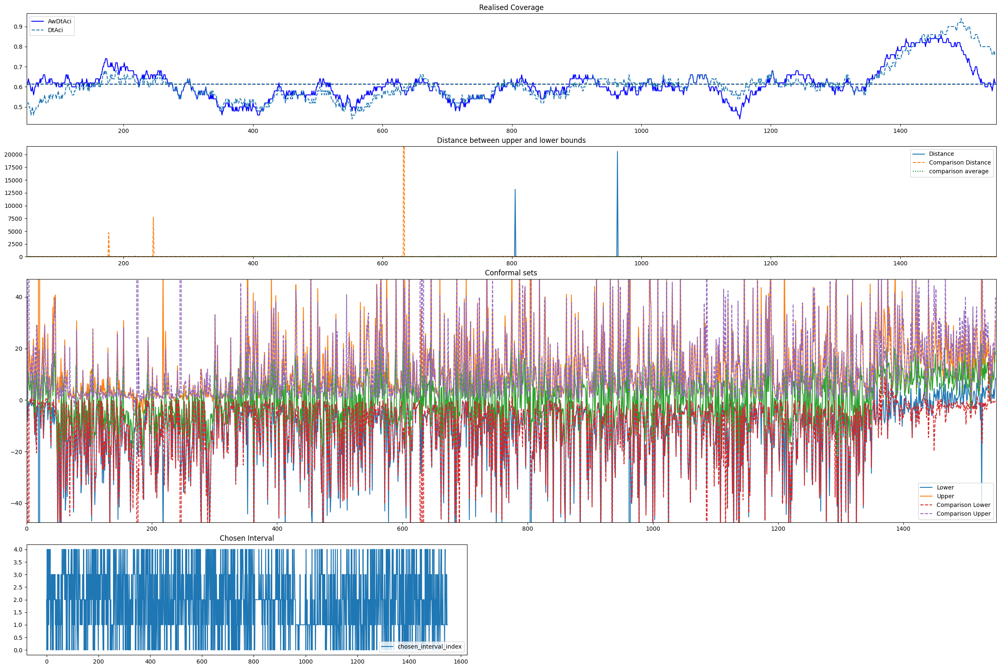

[np.float64(0.8308308308308309), np.float64(0.8288288288288288), np.float64(0.5235235235235236), np.float64(0.4154154154154154), np.float64(0.5595595595595595), np.float64(0.26726726726726724), np.float64(0.09209209209209213), np.float64(0.29729729729729726), np.float64(0.07907907907907907), np.float64(0.7017017017017018), np.float64(0.8268268268268268), np.float64(0.5775775775775776), np.float64(0.5935935935935936), np.float64(0.29229229229229226), np.float64(0.993993993993994), np.float64(0.3163163163163163), np.float64(0.8958958958958959), np.float64(0.986986986986987), np.float64(0.2502502502502503), np.float64(0.07007007007007005), np.float64(0.7257257257257257), np.float64(1.0), np.float64(0.6806806806806807), np.float64(0.14414414414414412), np.float64(0.14414414414414412), np.float64(0.3353353353353353), np.float64(0.7827827827827828), np.float64(0.1401401401401402), np.float64(1.0), np.float64(0.5835835835835836), np.float64(0.38138138138138133), np.float64(0.6986986986986987)

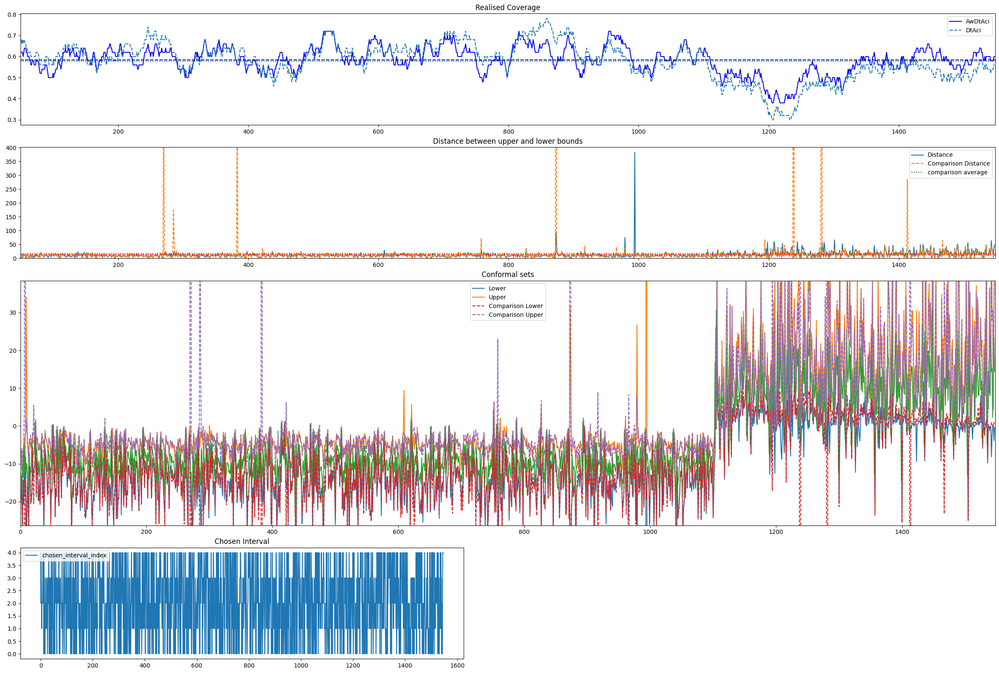

[np.float64(0.4044044044044044), np.float64(0.47947947947947944), np.float64(0.47947947947947944), np.float64(0.49049049049049054), np.float64(0.934934934934935), np.float64(0.5985985985985987), np.float64(0.6576576576576576), np.float64(0.6576576576576576), np.float64(0.991991991991992), np.float64(0.33933933933933935), np.float64(0.7817817817817818), np.float64(0.08108108108108114), np.float64(0.7107107107107107), np.float64(0.5415415415415415), np.float64(0.7897897897897898), np.float64(0.7717717717717718), np.float64(0.6326326326326326), np.float64(0.7037037037037037), np.float64(0.10210210210210213), np.float64(0.7367367367367368), np.float64(0.16216216216216217), np.float64(0.948948948948949), np.float64(0.8028028028028028), np.float64(0.8238238238238238), np.float64(0.8288288288288288), np.float64(0.24024024024024027), np.float64(0.30830830830830835), np.float64(0.0470470470470471), np.float64(0.8598598598598599), np.float64(0.18518518518518523), np.float64(0.6106106106106106), 

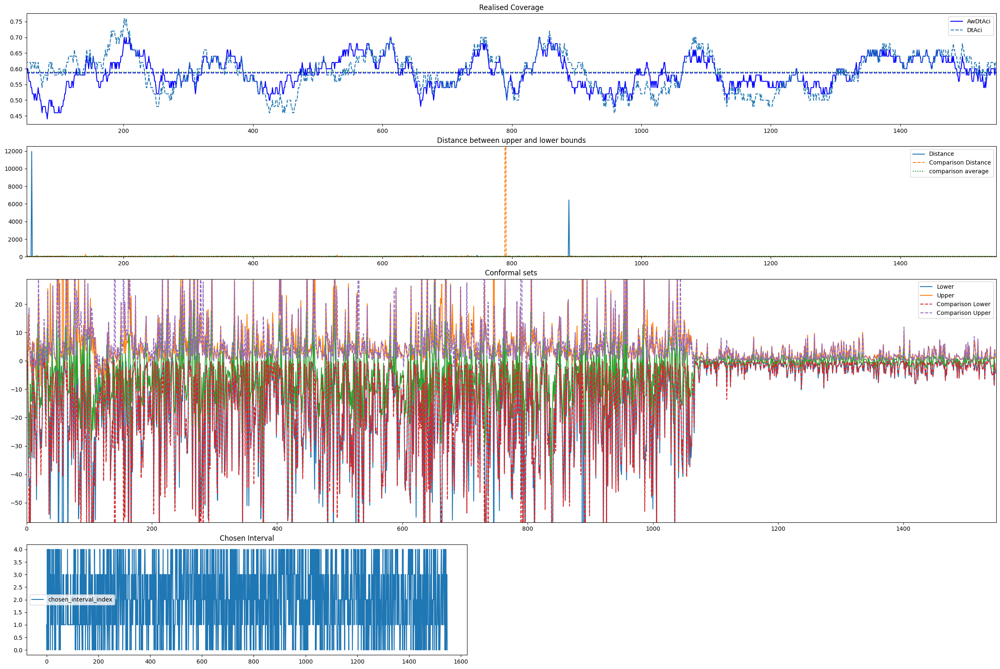

[np.float64(0.972972972972973), np.float64(0.1501501501501502), np.float64(0.05905905905905906), np.float64(0.6176176176176176), np.float64(0.41641641641641647), np.float64(0.6196196196196196), np.float64(0.15415415415415412), np.float64(0.5265265265265265), np.float64(0.9409409409409409), np.float64(0.7577577577577578), np.float64(0.8438438438438438), np.float64(0.8408408408408409), np.float64(0.7887887887887888), np.float64(0.950950950950951), np.float64(0.7177177177177176), np.float64(0.2492492492492493), np.float64(0.2492492492492493), np.float64(0.5935935935935936), np.float64(0.8308308308308309), np.float64(0.2592592592592593), np.float64(0.29329329329329334), np.float64(0.5845845845845845), np.float64(0.6856856856856857), np.float64(0.33333333333333337), np.float64(0.5395395395395395), np.float64(0.8508508508508509), np.float64(0.36436436436436437), np.float64(0.3933933933933934), np.float64(0.5205205205205206), np.float64(0.07907907907907907), np.float64(0.7887887887887888), np

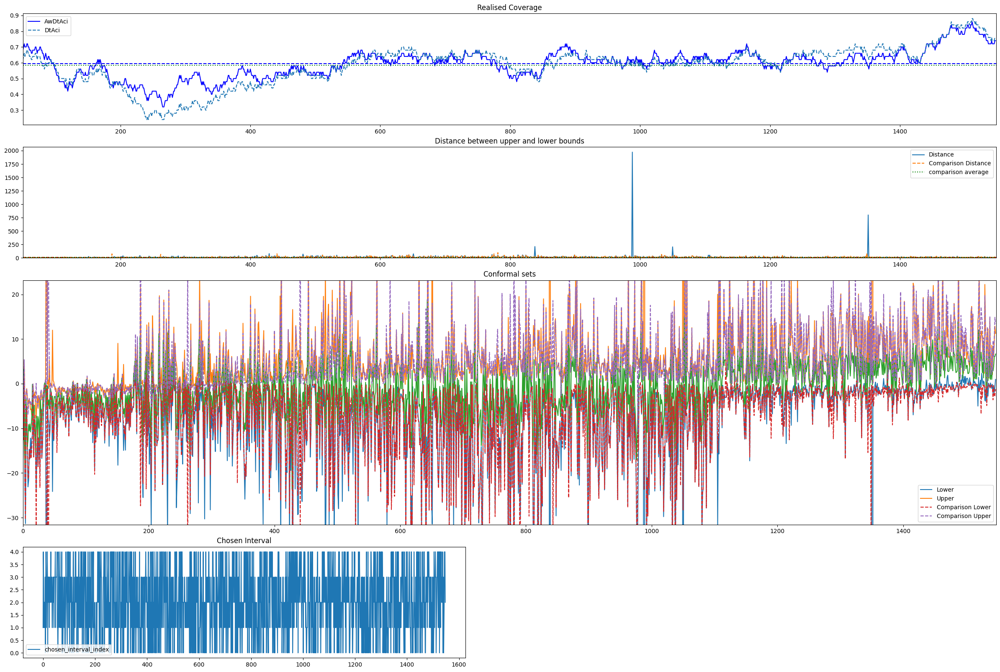

KeyboardInterrupt: 

In [90]:
all_random = ACP_data.random_multi_shift(20, (2000,2001))

cov = []
interval = []

for data in all_random:
    result = t.AwDtAci(data)
    cov.append(result['realised_interval_coverage'])
    interval.append(result['average_prediction_interval'])

    print('coverage:', np.mean(cov), 'interval: ', np.mean(interval))

    AwDT_plot(result, data, True)

    


[np.float64(0.024024024024024038), np.float64(0.3613613613613613), np.float64(0.6136136136136137), np.float64(0.034034034034034044), np.float64(0.5995995995995996), np.float64(0.9139139139139139), np.float64(0.48548548548548554), np.float64(0.06106106106106102), np.float64(0.3773773773773774), np.float64(0.46946946946946944), np.float64(0.3113113113113113), np.float64(0.3153153153153153), np.float64(0.20820820820820818), np.float64(0.8508508508508509), np.float64(0.29329329329329334), np.float64(0.7857857857857857), np.float64(0.10010010010010006), np.float64(0.4664664664664665), np.float64(0.7977977977977978), np.float64(0.08408408408408408), np.float64(0.9209209209209209), np.float64(0.5755755755755756), np.float64(0.002002002002001957), np.float64(0.8408408408408409), np.float64(0.5215215215215215), np.float64(0.993993993993994), np.float64(0.8358358358358359), np.float64(0.3213213213213213), np.float64(0.5355355355355356), np.float64(0.03903903903903905), np.float64(0.6126126126126

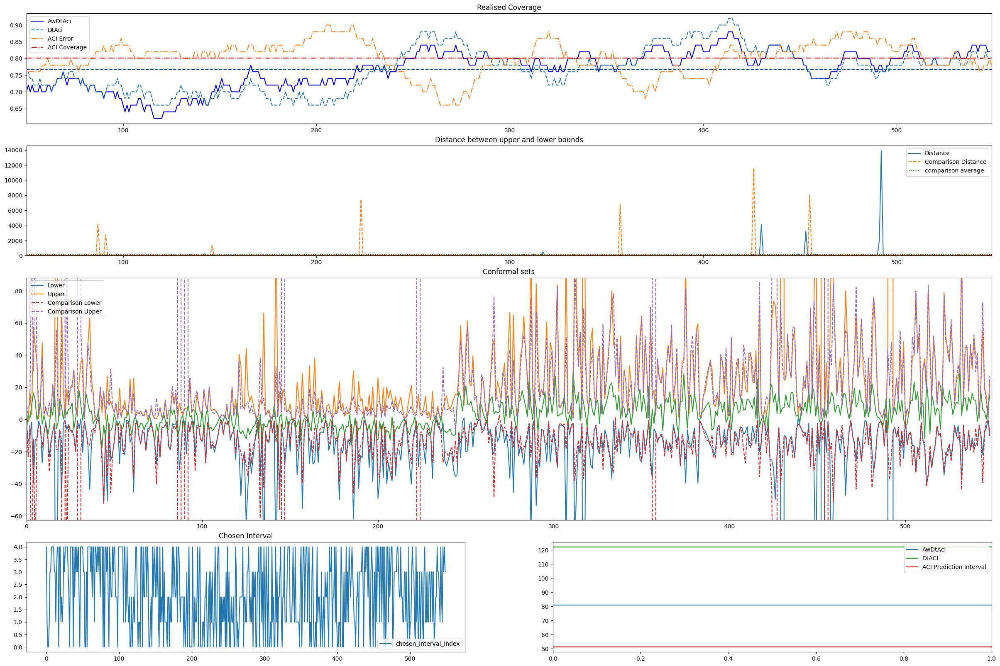

[np.float64(0.4194194194194194), np.float64(0.5175175175175175), np.float64(0.7957957957957957), np.float64(0.09809809809809811), np.float64(0.3013013013013013), np.float64(0.8048048048048049), np.float64(0.8948948948948949), np.float64(0.5715715715715716), np.float64(0.6386386386386387), np.float64(0.8198198198198199), np.float64(0.40240240240240244), np.float64(0.1501501501501502), np.float64(0.47447447447447444), np.float64(0.2592592592592593), np.float64(0.31831831831831836), np.float64(0.2802802802802803), np.float64(0.6026026026026026), np.float64(0.7497497497497497), np.float64(0.2852852852852853), np.float64(0.7307307307307307), np.float64(0.1911911911911912), np.float64(0.6636636636636637), np.float64(0.9189189189189189), np.float64(0.07007007007007005), np.float64(0.8648648648648649), np.float64(0.3623623623623624), np.float64(0.019019019019019034), np.float64(0.5145145145145145), np.float64(0.09609609609609615), np.float64(0.7877877877877878), np.float64(1.0), np.float64(0.8

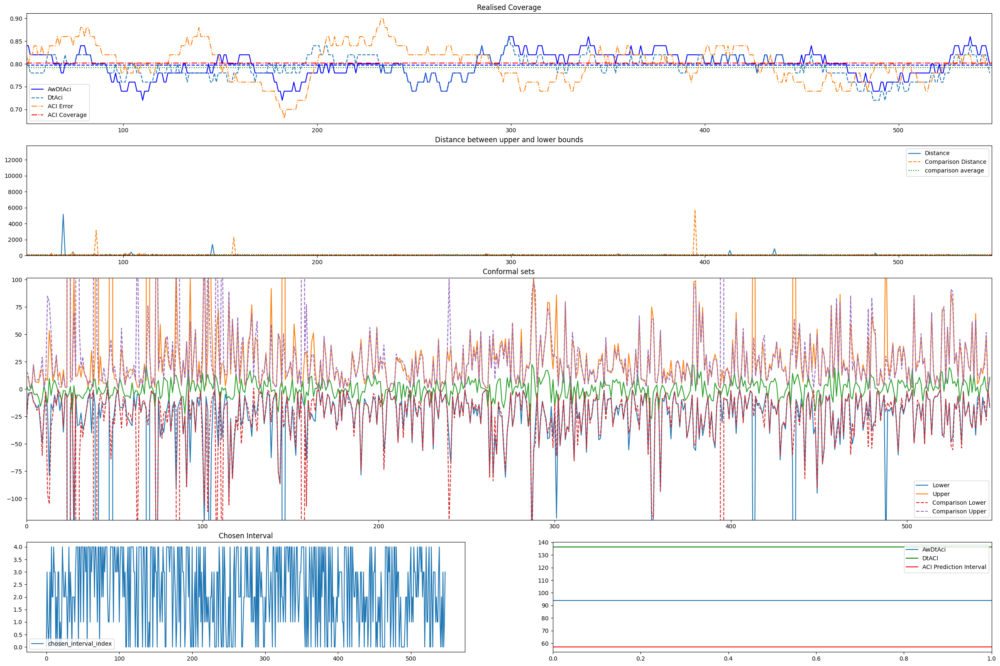

[np.float64(0.34434434434434436), np.float64(0.11711711711711714), np.float64(0.7727727727727728), np.float64(0.00800800800800805), np.float64(0.12012012012012008), np.float64(0.10310310310310311), np.float64(0.07407407407407407), np.float64(0.17817817817817816), np.float64(0.040040040040040026), np.float64(0.1861861861861862), np.float64(0.16716716716716717), np.float64(0.14314314314314314), np.float64(0.02102102102102099), np.float64(0.42342342342342343), np.float64(0.19619619619619622), np.float64(0.05805805805805808), np.float64(0.3993993993993994), np.float64(0.05305305305305308), np.float64(0.10610610610610616), np.float64(0.1511511511511512), np.float64(0.24624624624624625), np.float64(0.5105105105105106), np.float64(0.5105105105105106), np.float64(0.7377377377377378), np.float64(0.5155155155155156), np.float64(0.5155155155155156), np.float64(0.5925925925925926), np.float64(0.055055055055055035), np.float64(0.3943943943943944), np.float64(0.2272272272272272), np.float64(0.962962

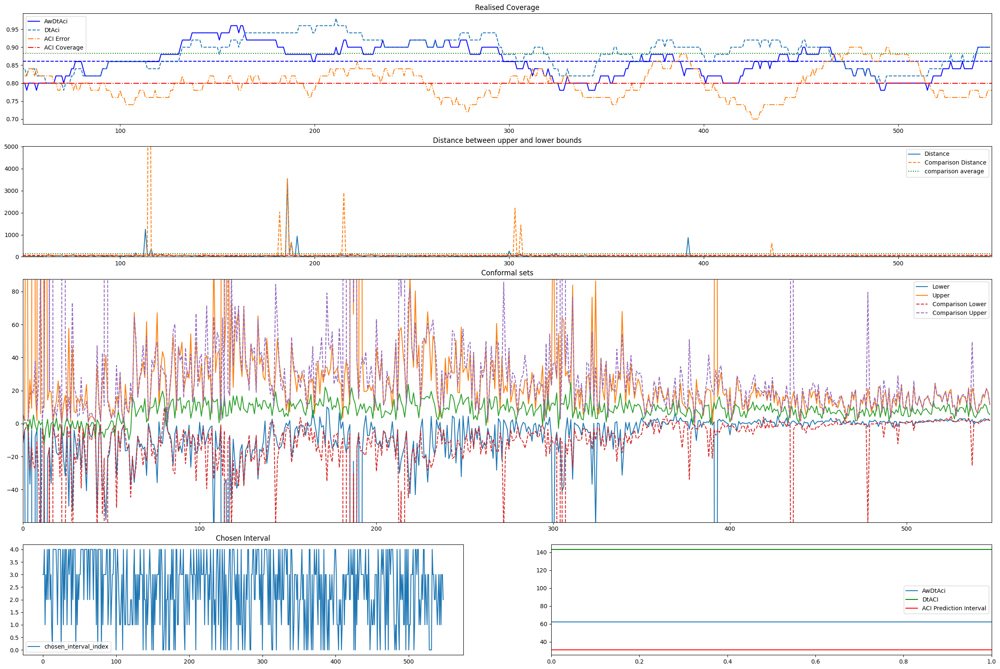

[np.float64(0.8308308308308309), np.float64(0.5525525525525525), np.float64(0.17417417417417413), np.float64(0.15215215215215216), np.float64(0.8358358358358359), np.float64(0.7537537537537538), np.float64(0.07407407407407407), np.float64(0.6386386386386387), np.float64(0.31931931931931934), np.float64(0.06006006006006004), np.float64(0.32432432432432434), np.float64(0.22122122122122123), np.float64(0.1501501501501502), np.float64(0.7507507507507507), np.float64(0.6846846846846847), np.float64(0.30930930930930933), np.float64(0.7657657657657657), np.float64(0.21621621621621623), np.float64(0.47947947947947944), np.float64(0.35935935935935936), np.float64(0.9179179179179179), np.float64(0.4984984984984985), np.float64(0.1811811811811812), np.float64(0.8578578578578578), np.float64(0.7627627627627628), np.float64(0.41141141141141147), np.float64(0.8438438438438438), np.float64(0.21121121121121122), np.float64(0.2842842842842843), np.float64(0.6226226226226226), np.float64(0.7317317317317

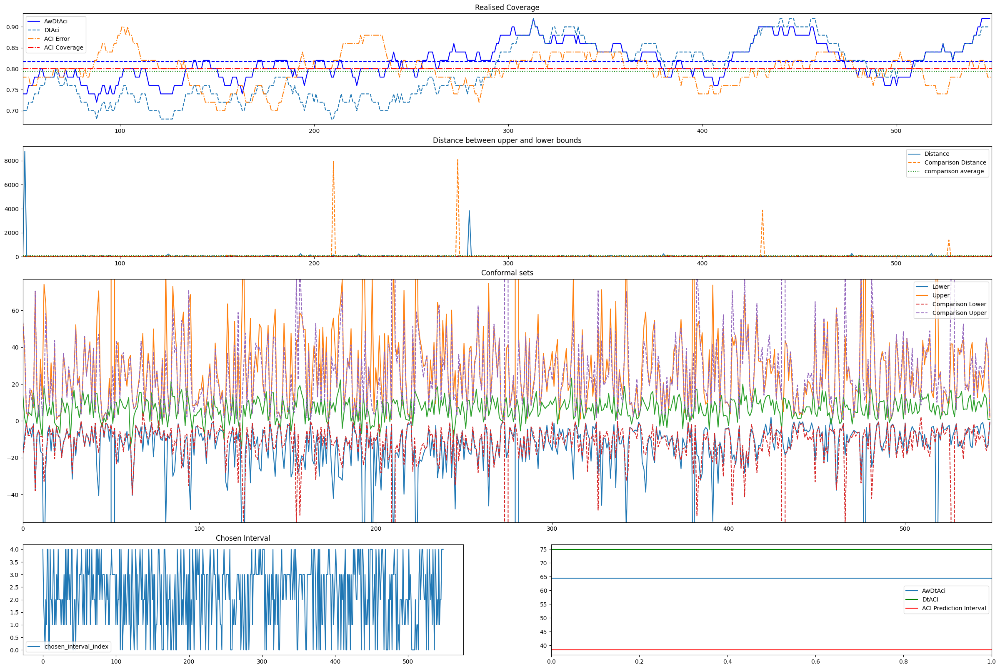

[np.float64(0.7197197197197197), np.float64(0.5725725725725725), np.float64(0.6486486486486487), np.float64(0.38038038038038036), np.float64(0.049049049049049054), np.float64(0.47347347347347346), np.float64(0.06906906906906907), np.float64(0.9529529529529529), np.float64(0.8418418418418419), np.float64(0.8418418418418419), np.float64(0.8538538538538538), np.float64(0.47347347347347346), np.float64(0.9239239239239239), np.float64(0.24224224224224222), np.float64(0.14814814814814814), np.float64(0.8398398398398399), np.float64(0.5055055055055055), np.float64(0.978978978978979), np.float64(0.2642642642642643), np.float64(0.6936936936936937), np.float64(0.8558558558558559), np.float64(0.29829829829829835), np.float64(0.8278278278278278), np.float64(0.36536536536536535), np.float64(0.0010010010010009784), np.float64(0.7247247247247247), np.float64(0.28228228228228225), np.float64(0.03703703703703709), np.float64(0.6266266266266266), np.float64(0.4354354354354354), np.float64(0.897897897897

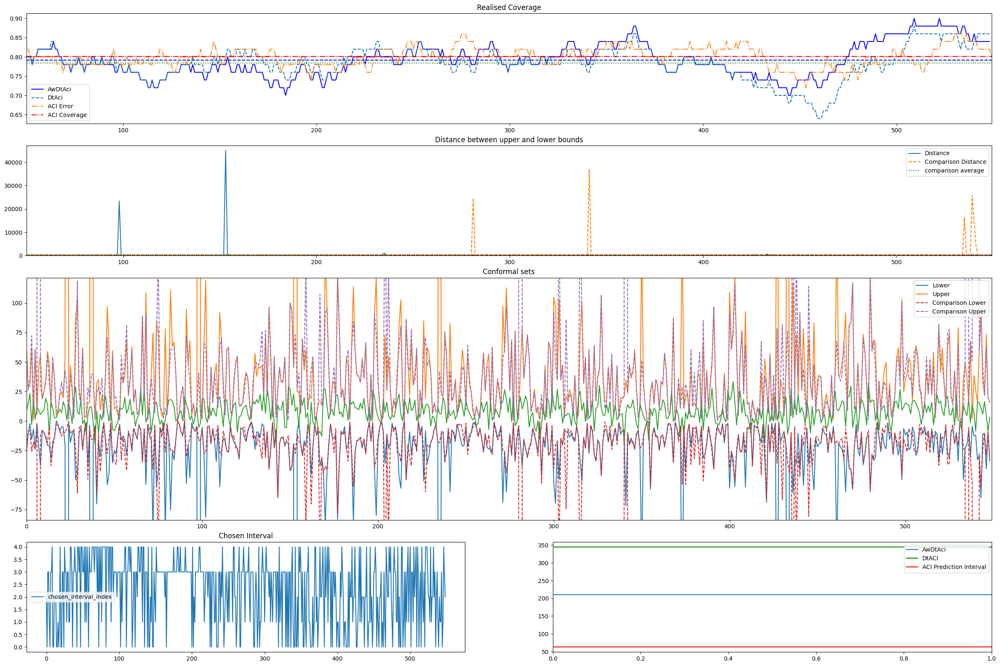

[np.float64(0.03903903903903905), np.float64(0.3983983983983984), np.float64(0.17417417417417413), np.float64(0.6296296296296297), np.float64(0.06506506506506504), np.float64(0.6096096096096096), np.float64(0.03903903903903905), np.float64(0.6016016016016016), np.float64(0.06306306306306309), np.float64(0.43843843843843844), np.float64(0.7217217217217218), np.float64(0.13713713713713716), np.float64(0.48048048048048053), np.float64(0.7187187187187187), np.float64(0.7857857857857857), np.float64(0.26126126126126126), np.float64(0.7947947947947948), np.float64(0.8538538538538538), np.float64(0.7347347347347347), np.float64(0.8588588588588588), np.float64(0.2392392392392393), np.float64(0.4824824824824825), np.float64(0.1351351351351351), np.float64(0.3683683683683684), np.float64(0.5935935935935936), np.float64(0.21821821821821819), np.float64(0.18318318318318316), np.float64(0.3683683683683684), np.float64(0.5895895895895895), np.float64(0.08208208208208212), np.float64(0.75275275275275

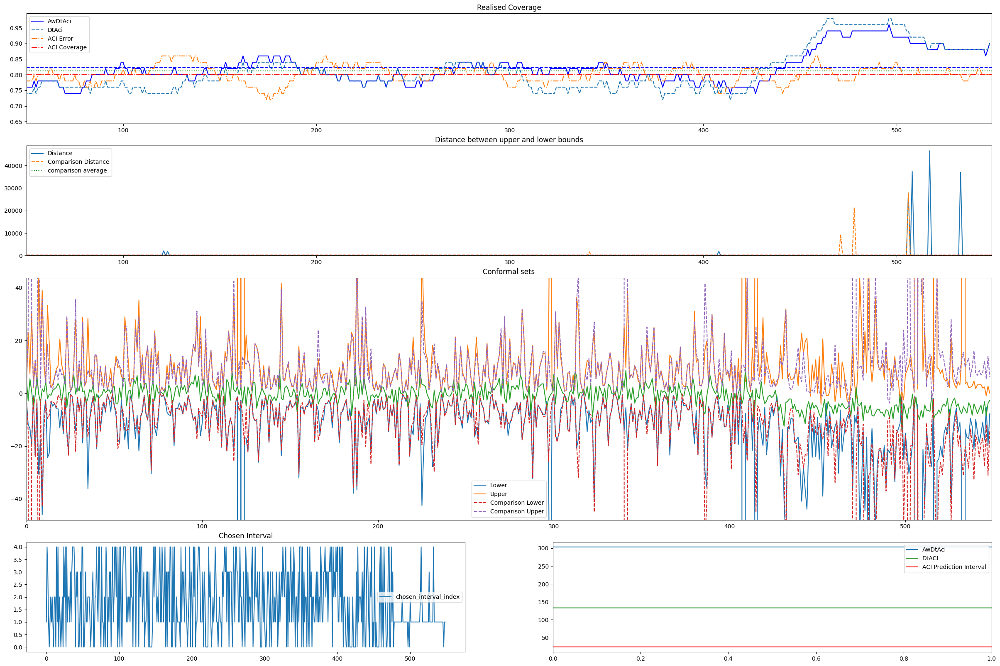

KeyboardInterrupt: 

In [103]:
all_random = ACP_data.random_multi_shift(10, (1000,1001), number_shift_range=(2,8))

cov = []
interval = []
results = []
t2 = test(0.2)

for data in all_random:
    result = t2.AwDtAci(data)

    results.append(result)

    cov.append(result['realised_interval_coverage'])
    interval.append(result['average_prediction_interval'])

    print('coverage:', np.mean(cov), 'interval: ', np.mean(interval))

    AwDT_plot(result, data, True)


So it consistently outperforms DtACI but does not outperfrom ACI itself, this is no suprise as DtACI does not outperform ACI itself so there is no way that it would anyway. Reelook at DTACI paper
.

# Testing when it chooses to shift

[np.float64(0.18918918918918914), np.float64(0.3363363363363363), np.float64(0.6836836836836837), np.float64(0.44744744744744747), np.float64(0.031031031031030998), np.float64(0.5245245245245245), np.float64(0.08008008008008005), np.float64(0.8208208208208209), np.float64(0.96996996996997), np.float64(0.9379379379379379), np.float64(0.11811811811811812), np.float64(0.44344344344344344), np.float64(0.5315315315315315), np.float64(0.00800800800800805), np.float64(0.5645645645645645), np.float64(0.8588588588588588), np.float64(0.3473473473473474), np.float64(0.031031031031030998), np.float64(0.8058058058058057), np.float64(0.973973973973974), np.float64(0.6896896896896897), np.float64(0.10310310310310311), np.float64(0.5535535535535536), np.float64(0.08908908908908908), np.float64(0.25625625625625625), np.float64(0.19619619619619622), np.float64(0.7297297297297297), np.float64(0.4554554554554555), np.float64(0.04504504504504503), np.float64(0.38638638638638634), np.float64(0.3193193193193

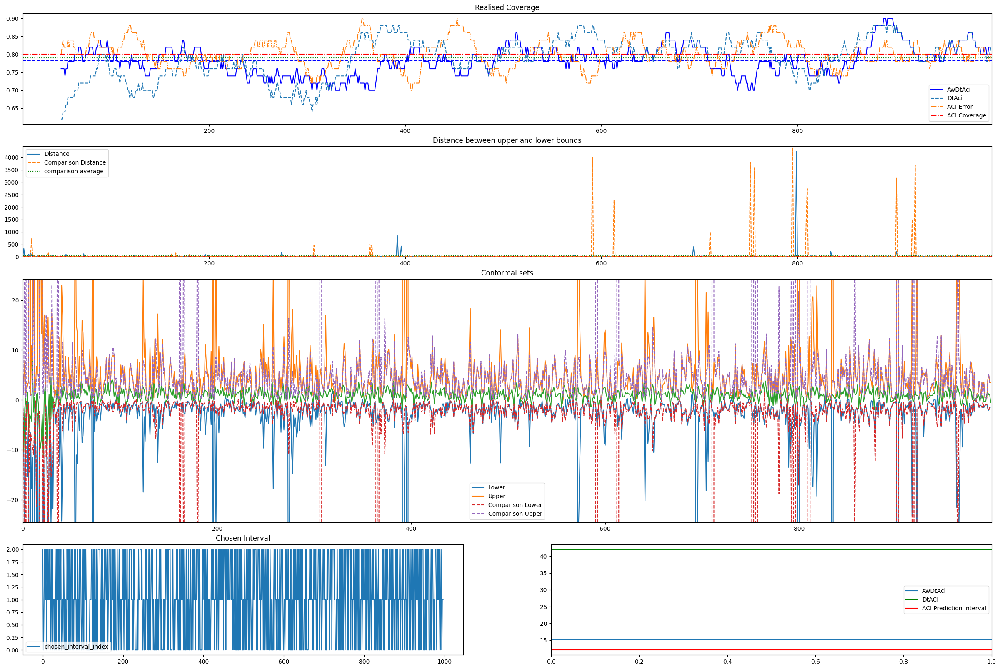

[np.float64(0.17017017017017022), np.float64(0.7847847847847848), np.float64(0.5125125125125125), np.float64(0.8138138138138138), np.float64(0.13313313313313313), np.float64(0.3723723723723724), np.float64(1.0), np.float64(0.7967967967967968), np.float64(0.6526526526526526), np.float64(0.08008008008008005), np.float64(0.1761761761761762), np.float64(0.5395395395395395), np.float64(0.21821821821821819), np.float64(0.3983983983983984), np.float64(0.5815815815815816), np.float64(0.3563563563563563), np.float64(0.6006006006006006), np.float64(0.6006006006006006), np.float64(0.6766766766766767), np.float64(0.6806806806806807), np.float64(0.29729729729729726), np.float64(0.10410410410410409), np.float64(0.9189189189189189), np.float64(0.33933933933933935), np.float64(0.27227227227227224), np.float64(0.8188188188188188), np.float64(0.41241241241241244), np.float64(0.8668668668668669), np.float64(0.924924924924925), np.float64(1.0), np.float64(0.8518518518518519), np.float64(0.5045045045045045

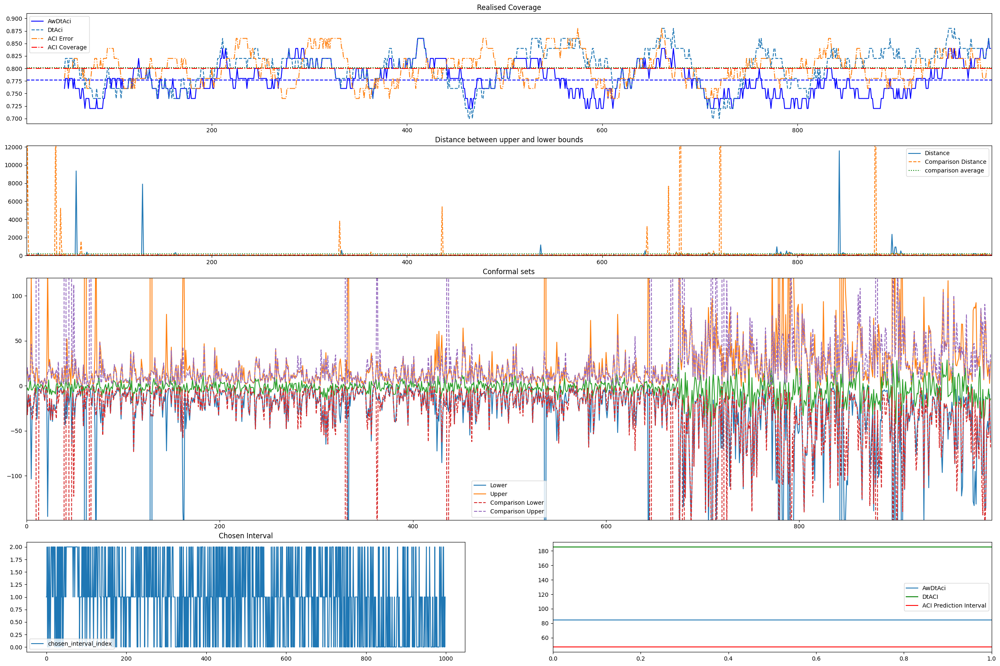

[np.float64(0.3363363363363363), np.float64(0.914914914914915), np.float64(0.4964964964964965), np.float64(0.5235235235235236), np.float64(0.4814814814814815), np.float64(0.3483483483483484), np.float64(0.35935935935935936), np.float64(0.7837837837837838), np.float64(0.9819819819819819), np.float64(0.46946946946946944), np.float64(0.5865865865865866), np.float64(0.8128128128128128), np.float64(0.990990990990991), np.float64(0.48048048048048053), np.float64(0.7307307307307307), np.float64(0.4184184184184184), np.float64(0.48948948948948945), np.float64(0.8448448448448449), np.float64(0.17517517517517522), np.float64(0.6686686686686687), np.float64(0.1861861861861862), np.float64(0.49549549549549554), np.float64(0.8908908908908909), np.float64(0.3723723723723724), np.float64(0.5115115115115115), np.float64(0.11711711711711714), np.float64(0.4104104104104104), np.float64(0.4764764764764765), np.float64(0.4764764764764765), np.float64(0.7107107107107107), np.float64(0.28828828828828834), n

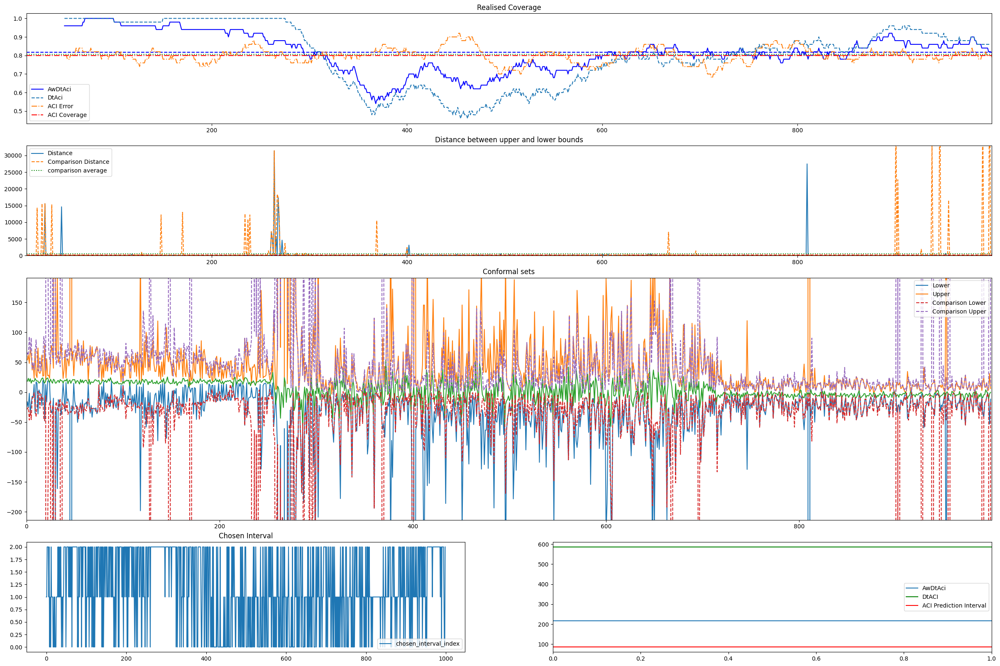

[np.float64(0.6746746746746747), np.float64(0.3673673673673674), np.float64(0.2602602602602603), np.float64(0.026026026026025995), np.float64(0.7917917917917918), np.float64(0.5565565565565566), np.float64(0.28728728728728725), np.float64(0.012012012012012074), np.float64(0.953953953953954), np.float64(0.8568568568568569), np.float64(0.7907907907907907), np.float64(0.6616616616616617), np.float64(0.988988988988989), np.float64(0.6016016016016016), np.float64(0.6596596596596597), np.float64(0.41741741741741745), np.float64(0.4254254254254254), np.float64(0.7377377377377378), np.float64(0.5325325325325325), np.float64(0.23623623623623624), np.float64(0.04504504504504503), np.float64(0.8008008008008007), np.float64(0.2022022022022022), np.float64(0.1511511511511512), np.float64(0.1511511511511512), np.float64(0.45345345345345345), np.float64(0.3463463463463463), np.float64(0.10710710710710714), np.float64(0.44244244244244246), np.float64(0.1341341341341341), np.float64(0.8548548548548549)

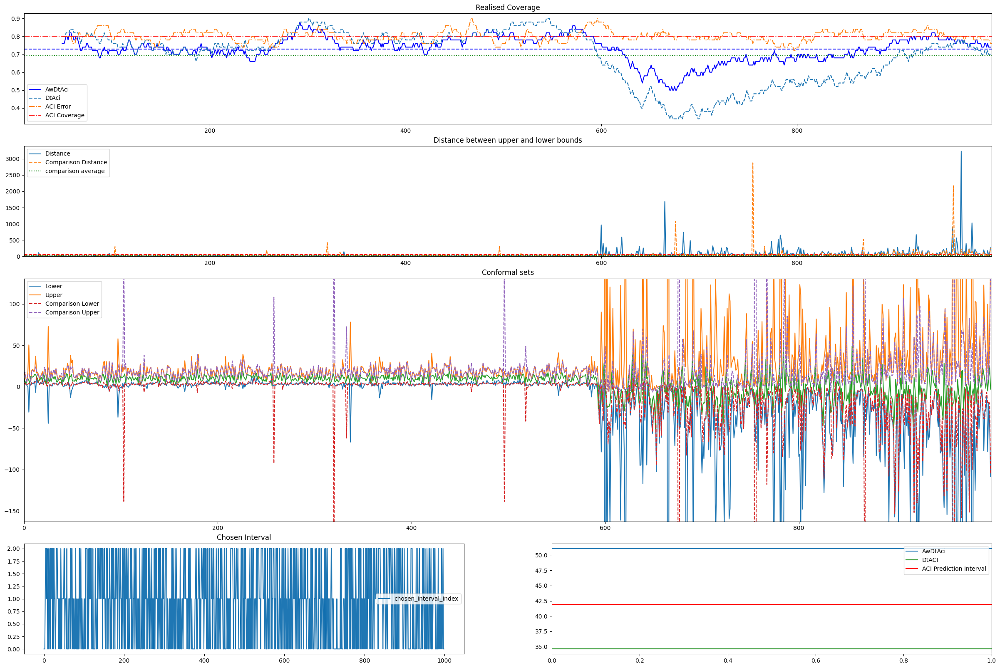

UnboundLocalError: cannot access local variable 'B_t' where it is not associated with a value

In [105]:
# Similar data but will allow the changes to be a lot more pronounced so can better see the effects.
all_random = ACP_data.random_multi_shift(10, (1500,1501), dist_range=((-10, 1), (20, 20)), number_shift_range=(2,4))

cov = []
interval = []
results = []

t2 = test(0.2)

for data in all_random:
    result = t2.AwDtAci(data, [10, 250, 500])

    results.append(result)

    cov.append(result['realised_interval_coverage'])
    interval.append(result['average_prediction_interval'])

    print('coverage:', np.mean(cov), 'interval: ', np.mean(interval))

    AwDT_plot(result, data, True)